# Exploratory Data Analysis

### Contexto

Se han recopilado datos socio demográficos y de recursos de salud por condado en los Estados Unidos y queremos descubrir si existe alguna relación entre los recursos sanitarios y los datos socio demográficos.

Usare un modelo de regresion lineal para establecer esta correlacion

Mi target sera la prevalencia de la suma de las enfermedades 'anycondition_prevalence'

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from sklearn.preprocessing import OneHotEncoder
import json

## Importado de datos

In [2]:
# Importo el csv desde una URL y lo guardo

url = 'https://raw.githubusercontent.com/4GeeksAcademy/regularized-linear-regression-project-tutorial/main/demographic_health_data.csv'

df = pd.read_csv(url, sep=',' )

# Guardo el archivo
df.to_csv('../data/raw/Data.csv', index = False )

In [3]:
df.head().transpose()

,0,1,2,3,4
fips,1001,1003,1005,1007,1009
TOT_POP,55601,218022,24881,22400,57840
0-9,6787,24757,2732,2456,7095
0-9 y/o % of total pop,12.206615,11.355276,10.980266,10.964286,12.266598
19-Oct,7637,26913,2960,2596,7570
...,...,...,...,...,...
CKD_prevalence,3.1,3.2,4.5,3.3,3.4
CKD_Lower 95% CI,2.9,3.0,4.2,3.1,3.2
CKD_Upper 95% CI,3.3,3.5,4.8,3.6,3.7
CKD_number,1326,5479,887,595,1507


In [4]:
# Informacion de la estructura del DataFrame
print(df.shape)
df.info(verbose=True, show_counts=True)

(3140, 108)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3140 entries, 0 to 3139
Data columns (total 108 columns):
 #    Column                                                                         Non-Null Count  Dtype  
---   ------                                                                         --------------  -----  
 0    fips                                                                           3140 non-null   int64  
 1    TOT_POP                                                                        3140 non-null   int64  
 2    0-9                                                                            3140 non-null   int64  
 3    0-9 y/o % of total pop                                                         3140 non-null   float64
 4    19-Oct                                                                         3140 non-null   int64  
 5    10-19 y/o % of total pop                                                       3140 non-null   float64
 6    20

Primero eliminare todos los datos ID o nombres que sean identificadores individuales

In [5]:
df.drop(columns=['fips', 'STATE_FIPS', 'Urban_rural_code', 'COUNTY_NAME', 'STATE_NAME', 'STATE_FIPS', 'CNTY_FIPS' ], inplace=True)

Este dataset tiene 3140 filas y 108 columnas con las que trabajar, dadas las dimensiones y que observando el titulo de estas columnas, considero que puede que algunas tengan correlaciones muy altas entre ellas, por lo tanto lo primero sera observar esto, para disminuir las dimensiones.

Antes de continuar, voy a definir mi target en "Any condition prevalence", es un indicador de la prevalencia de una enfermedad sobre la poblacion estudiada.

In [6]:
# Renombrar la columna "anycondition_prevalence" a "target"
df = df.rename(columns={'anycondition_prevalence': 'target'})

# Obtener todas las columnas excepto "target"
cols = [col for col in df.columns if col != 'target']

# Reordenar el DataFrame para que "target" quede como última columna
df = df[cols + ['target']]

Las columnas restantes son unicamente numericas, por lo tanto hare el heatmap para poder observar estas correlaciones.

In [7]:
fig, axis = plt.subplots(figsize=(60, 60), dpi=300)

sns.heatmap(df.corr(), annot=True, fmt=".2f", cmap="coolwarm")
plt.savefig('../data/processed/heatmap.png')

# Guardo el archivo para poder observarlo externamente, el jup nb no me permite ampliar

Se puede observar una alta correlacion entre una gran cantidad de variables. Esto significa que hay variables que podemos eliminar por la alta colinealidad entre ellas.

Hay que tener en cuenta que la mayoria de datos parece que pertenece a poblacion blanca por la alta correlacion de 'White-alone pop' con 'TOT_POP'. Esta columna tendre que protegerla para que no sea eliminada, ya que me interesa/

Tambien quiero manterner a la poblacion mayor de 60 y el numero de hospitales

In [8]:
from funciones import eliminar_variables_alta_correlacion


# Voy a proteger 'White-alone pop'
col_protec = ['White-alone pop', 'Total Hospitals (2019)', 'Population Aged 60+']
df_redu = eliminar_variables_alta_correlacion(df = df, target_col='target', umbral=0.9, umbral_target=0.9, cols_protegidas=col_protec)

Variables eliminadas: ['0-9', '19-Oct', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80+', 'Two or more races pop', 'POP_ESTIMATE_2018', 'GQ_ESTIMATES_2018', 'R_NET_MIG_2018', 'Less than a high school diploma 2014-18', 'High school diploma only 2014-18', "Some college or associate's degree 2014-18", "Bachelor's degree or higher 2014-18", 'POVALL_2018', 'PCTPOV017_2018', 'PCTPOV517_2018', 'CI90LBINC_2018', 'CI90UBINC_2018', 'Civilian_labor_force_2018', 'Employed_2018', 'Unemployed_2018', 'Median_Household_Income_2018', 'Total Active Patient Care Physicians per 100000 Population 2018 (AAMC)', 'Active Primary Care Physicians per 100000 Population 2018 (AAMC)', 'Active Patient Care Primary Care Physicians per 100000 Population 2018 (AAMC)', 'Active Patient Care General Surgeons per 100000 Population 2018 (AAMC)', 'Total nurse practitioners (2019)', 'Total physician assistants (2019)', 'Internal Medicine Primary Care (2019)', 'Family Medicine/General Practice Primary Care (2019)',

Vuelvo a imprimir mi heatmap para comprobar mis datos despues de los cambios

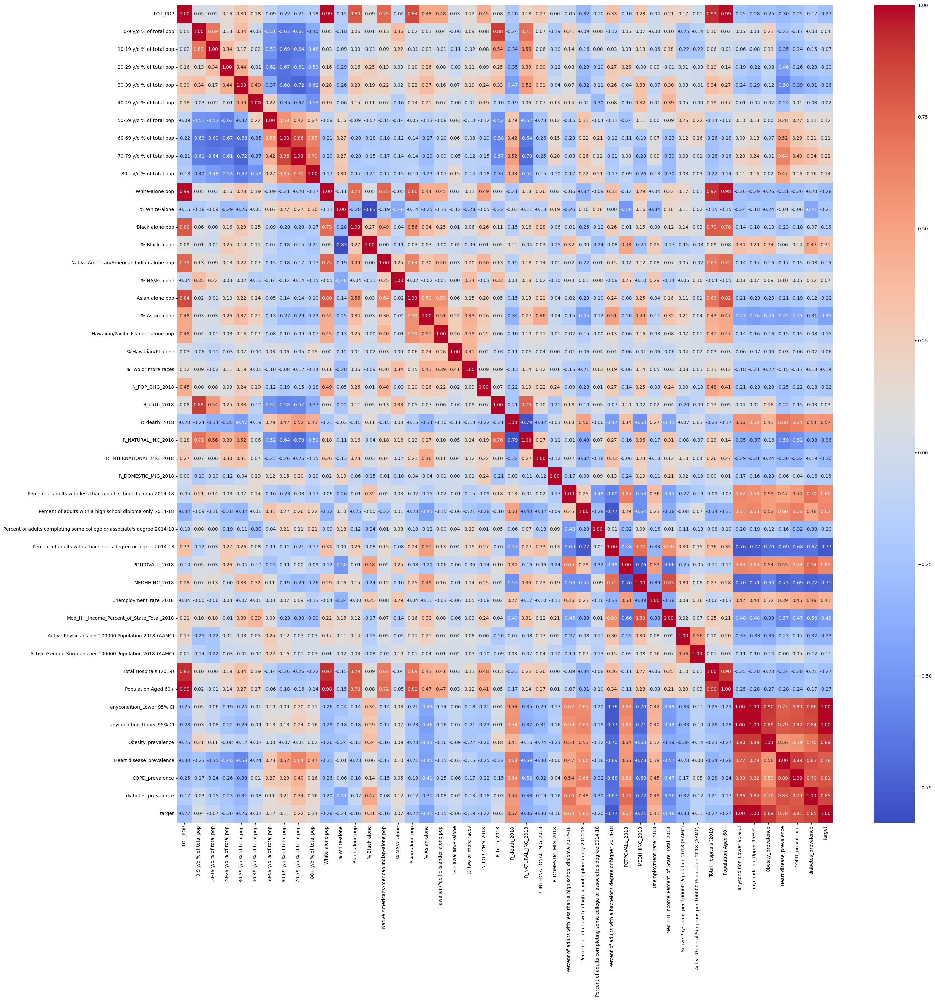

In [9]:
fig, axis = plt.subplots(figsize=(30, 30))

sns.heatmap(df_redu.corr(), annot=True, fmt=".2f", cmap="coolwarm")

plt.tight_layout()
plt.show()

Con esto he conseguido eliminar todas aquellas columnas con una alta correlacion entre si, pero manteniendo las que tienen mas de un 90% de correlacion con mi target. De esta manera, puedo comprobar las variables con alta correlacion con mi target y en caso de ser necesario, eliminarlas manualmente.

Puedo observar que anycondition_Lower 95% CI, anycondition_Upper 95% CI tienen una correlacion de 1 con mi target, por lo tanto estos datos son redundantes e introducirian ruido. Los eliminare.

In [10]:
df_redu.drop(columns=['anycondition_Lower 95% CI','anycondition_Upper 95% CI'], inplace=True)

## Estudio multivariable

Pasare directamente al estudio multivariable, hare una comparativa entre las columnas que considero de mayor interes con mi target.

In [11]:
df_redu.columns

Index(['TOT_POP', '0-9 y/o % of total pop', '10-19 y/o % of total pop',
       '20-29 y/o % of total pop', '30-39 y/o % of total pop',
       '40-49 y/o % of total pop', '50-59 y/o % of total pop',
       '60-69 y/o % of total pop', '70-79 y/o % of total pop',
       '80+ y/o % of total pop', 'White-alone pop', '% White-alone',
       'Black-alone pop', '% Black-alone',
       'Native American/American Indian-alone pop', '% NA/AI-alone',
       'Asian-alone pop', '% Asian-alone',
       'Hawaiian/Pacific Islander-alone pop', '% Hawaiian/PI-alone',
       '% Two or more races', 'N_POP_CHG_2018', 'R_birth_2018', 'R_death_2018',
       'R_NATURAL_INC_2018', 'R_INTERNATIONAL_MIG_2018', 'R_DOMESTIC_MIG_2018',
       'Percent of adults with less than a high school diploma 2014-18',
       'Percent of adults with a high school diploma only 2014-18',
       'Percent of adults completing some college or associate's degree 2014-18',
       'Percent of adults with a bachelor's degree or higher 20

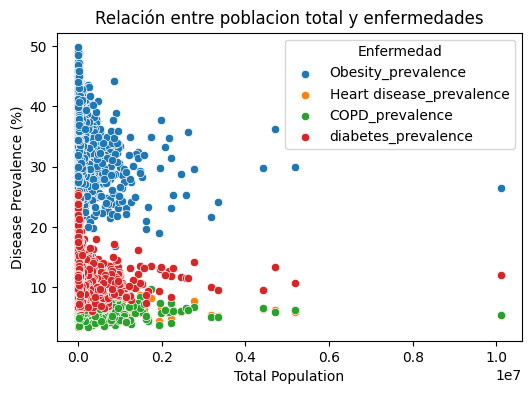

In [12]:
disease_prevalence = ['Obesity_prevalence', 'Heart disease_prevalence', 'COPD_prevalence', 'diabetes_prevalence']

plt.figure(figsize=(6, 4))
for disease in disease_prevalence:
    sns.scatterplot(x=df['TOT_POP'], y=df_redu[disease], label=disease)
plt.xlabel("Total Population")
plt.ylabel("Disease Prevalence (%)")
plt.legend(title="Enfermedad")
plt.title("Relación entre poblacion total y enfermedades")
plt.show()

Podemos ver una correlacion entre las diferentes enfermedades y la target, que engloba todas ellas, siendo la mas prevalente la obesidad y las otras tres teniendo porcentajes menores cerca del mismo tramo.

## Enfermedad por etnia

Ahora comprobare las diferentes enfermedades con las etnias, para ver si hay relaciones entre ellas, pudiendo indicar esto ciertas inclinaciones geneticas a determinadas enfermedades.

### Nativos americanos

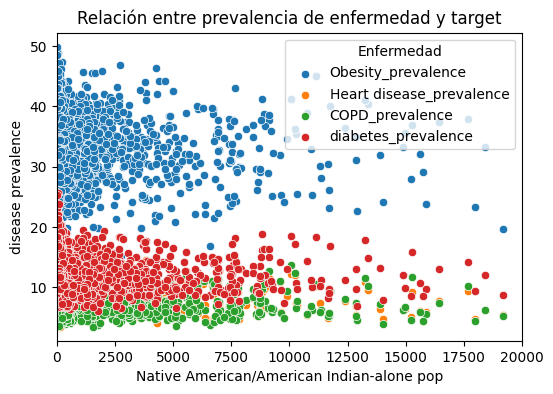

In [13]:
plt.figure(figsize=(6, 4))
for disease in disease_prevalence:
    sns.scatterplot(y=df[disease], x=df_redu['Native American/American Indian-alone pop'], label=disease).set_xlim(0,20000)
plt.xlabel("Native American/American Indian-alone pop")
plt.ylabel("disease prevalence")
plt.legend(title="Enfermedad")
plt.title("Relación entre prevalencia de enfermedad y target")
plt.show()

Se puede ver que la enfermedad con mayor aparicion es la obesidad, seguida de la diabetes, el COPD y enfermedadesd el corazon se encuentran a la par.

### Afroamericanos

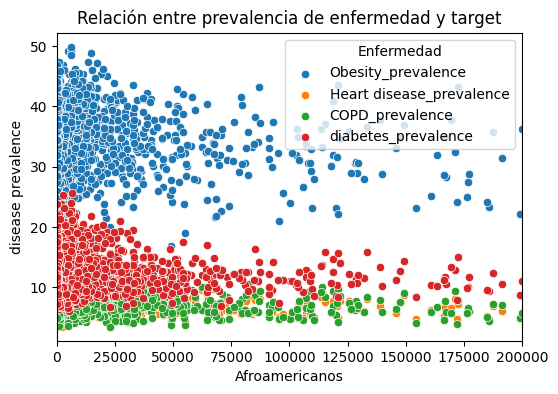

In [14]:
plt.figure(figsize=(6, 4))
for disease in disease_prevalence:
    sns.scatterplot(y=df[disease], x=df_redu['Black-alone pop'], label=disease).set_xlim(0,200000)
plt.xlabel("Afroamericanos")
plt.ylabel("disease prevalence")
plt.legend(title="Enfermedad")
plt.title("Relación entre prevalencia de enfermedad y target")
plt.show()

### Blancos

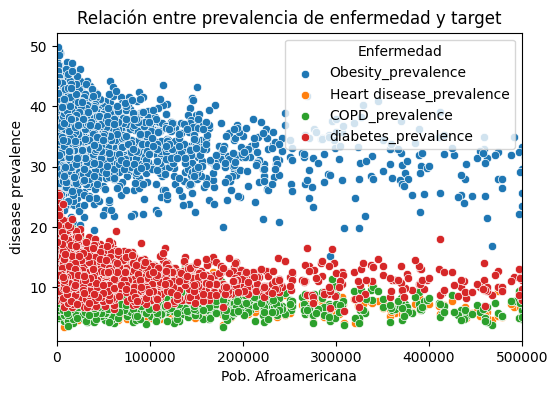

In [15]:
plt.figure(figsize=(6, 4))
for disease in disease_prevalence:
    sns.scatterplot(y=df[disease], x=df_redu['White-alone pop'], label=disease).set_xlim(0,500000)
plt.xlabel("Pob. Afroamericana")
plt.ylabel("disease prevalence")
plt.legend(title="Enfermedad")
plt.title("Relación entre prevalencia de enfermedad y target")
plt.show()

### Asiatica

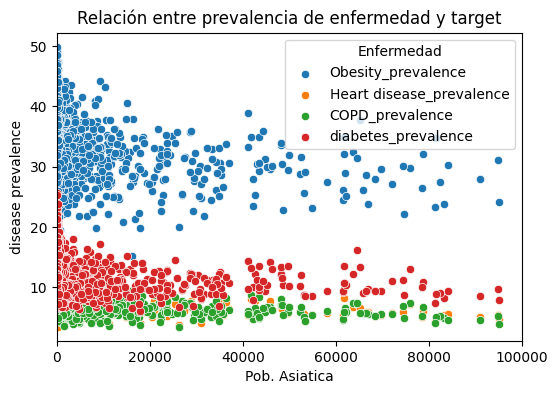

In [16]:
plt.figure(figsize=(6, 4))
for disease in disease_prevalence:
    sns.scatterplot(y=df[disease], x=df_redu['Asian-alone pop'], label=disease).set_xlim(0,100000)
plt.xlabel("Pob. Asiatica")
plt.ylabel("disease prevalence")
plt.legend(title="Enfermedad")
plt.title("Relación entre prevalencia de enfermedad y target")
plt.show()

### Hawaiana

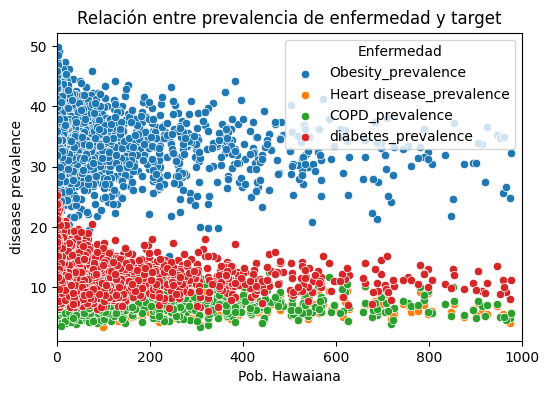

In [17]:
plt.figure(figsize=(6, 4))
for disease in disease_prevalence:
    sns.scatterplot(y=df[disease], x=df_redu['Hawaiian/Pacific Islander-alone pop'], label=disease).set_xlim(0,1000)
plt.xlabel("Pob. Hawaiana")
plt.ylabel("disease prevalence")
plt.legend(title="Enfermedad")
plt.title("Relación entre prevalencia de enfermedad y target")
plt.show()

Tras este analisis, podemos observar que la prevalencia de las enfermedades es muy similar en todas las etnias de las que tenemos informacion, con algunas variaciones en el numero de diabetes llegando a porcentajes de casi el 30% en todas ellas.

## Analisis de Outliers

In [18]:
df_redu.shape

(3140, 44)

Tengo 44 columnas por lo tanto voy a dibujarlo en una sola figura para ahorrar espacio

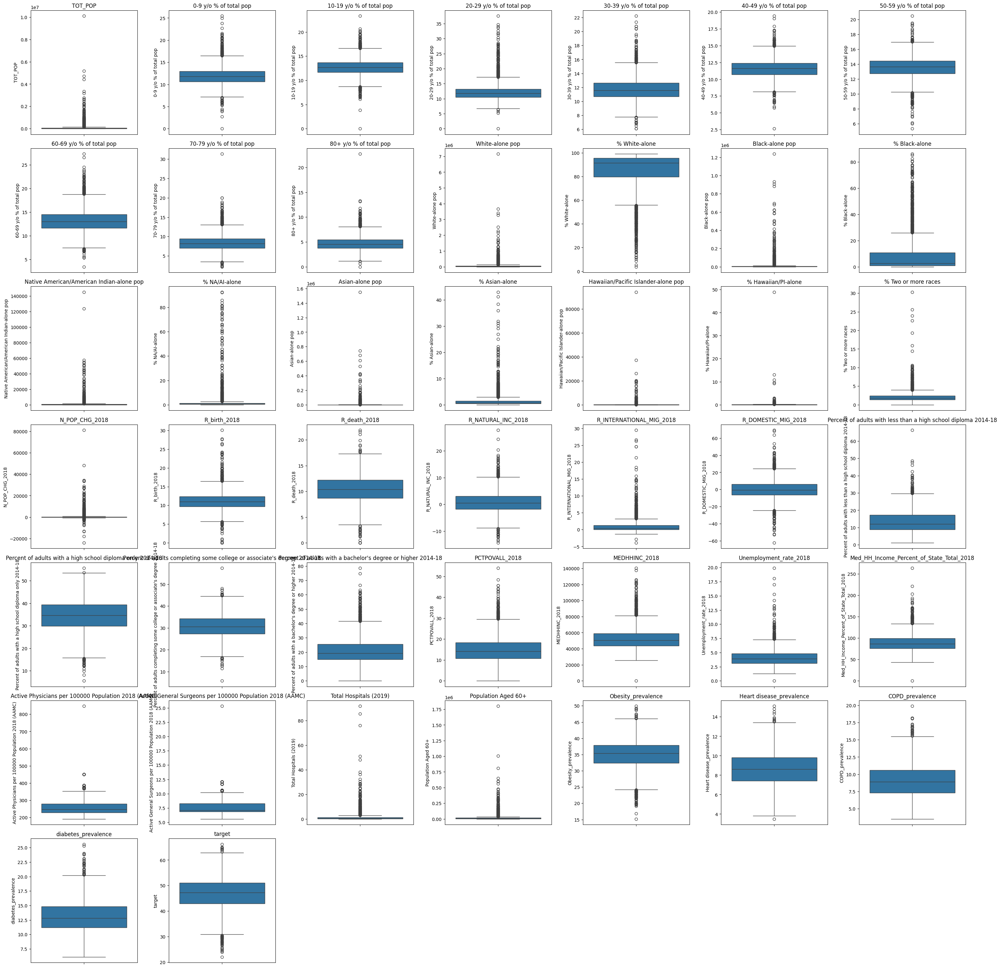

In [19]:
# Supongamos que df_redu tiene n columnas
n_cols = len(df_redu.columns)
# Puedes definir el número de filas y columnas de la grilla de forma dinámica.
n_grid = int(n_cols**0.5) + 1

fig, axes = plt.subplots(n_grid, n_grid, figsize=(30, 30))
axes = axes.flatten()  # Para facilitar la iteración

for idx, column in enumerate(df_redu.columns):
    sns.boxplot(data=df_redu, y=df_redu[column], ax=axes[idx])
    axes[idx].set_title(column)

# Si quedan ejes sin asignar, los ocultamos
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

Puedo observar que tengo outliers en todas mis categorias.

# Preparacion Datasets para ML

In [20]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.feature_selection import f_classif, SelectKBest

## Reemplazo de Outliers

In [23]:
from funciones import reemplazar_outliers


y = df_redu['target']

X_con_outliers = df_redu.drop(columns='target').copy()
X_sin_outliers = df_redu.drop(columns='target').copy()

# Para la versión SIN outliers (se reemplazan los outliers en las columnas numéricas)
outliers_dict = {}
for col in X_sin_outliers.columns:
    X_sin_outliers, limits = reemplazar_outliers(col, X_sin_outliers)
    outliers_dict[col] = limits

# Guardamos la información de reemplazo de outliers en JSON (convertida a tipos nativos)
outliers_dict_serializable = {col: [float(l), float(u)] for col, (l, u) in outliers_dict.items()}
with open("../data/outliers_replacement.json", "w") as f:
    json.dump(outliers_dict_serializable, f)

## Division Train/Test

In [24]:
X_train_con_raw, X_test_con_raw, y_train, y_test = train_test_split(X_con_outliers, y, test_size=0.2, random_state=42)
# Para la versión SIN outliers usamos los mismos índices
X_train_sin_raw = X_sin_outliers.loc[X_train_con_raw.index]
X_test_sin_raw  = X_sin_outliers.loc[X_test_con_raw.index]


# Guardamos los targets por separado
y_train.to_excel("../data/processed/y_train.xlsx", index=False)
y_test.to_excel("../data/processed/y_test.xlsx", index=False)

## Normalizacion

In [25]:
from funciones import normalizar_datos

# Rama CON outliers
X_train_con_norm, X_test_con_norm = normalizar_datos(
    X_train_con_raw, X_test_con_raw, "../models/normalizador_con_outliers.pkl"
)
# Rama SIN outliers
X_train_sin_norm, X_test_sin_norm = normalizar_datos(
    X_train_sin_raw, X_test_sin_raw, "../models/normalizador_sin_outliers.pkl"
)

## Escalado Min/Max

In [26]:
from funciones import escalado_min_max

# Rama CON outliers
X_train_con_scal, X_test_con_scal = escalado_min_max(X_train_con_raw, X_test_con_raw, "../models/minmax_scaler_con.pkl")

# Rama SIN outliers
X_train_sin_scal, X_test_sin_scal = escalado_min_max(X_train_sin_raw, X_test_sin_raw, "../models/minmax_scaler_sin.pkl")

In [27]:
# Versión CON outliers:
# - RAW: X_train_con_outliers_raw_oh.xlsx y X_test_con_outliers_raw_oh.xlsx
# - NORM: X_train_con_outliers_norm_oh.xlsx y X_test_con_outliers_norm_oh.xlsx
# - SCAL: X_train_con_outliers_scal_oh.xlsx y X_test_con_outliers_scal_oh.xlsx
X_train_con_raw.to_excel("../data/processed/X_train_con_outliers_raw.xlsx", index=False)
X_test_con_raw.to_excel("../data/processed/X_test_con_outliers_raw.xlsx", index=False)
X_train_con_norm.to_excel("../data/processed/X_train_con_outliers_norm.xlsx", index=False)
X_test_con_norm.to_excel("../data/processed/X_test_con_outliers_norm.xlsx", index=False)
X_train_con_scal.to_excel("../data/processed/X_train_con_outliers_scal.xlsx", index=False)
X_test_con_scal.to_excel("../data/processed/X_test_con_outliers_scal.xlsx", index=False)

# Versión SIN outliers:
# - RAW: X_train_sin_outliers_raw_oh.xlsx y X_test_sin_outliers_raw_oh.xlsx
# - NORM: X_train_sin_outliers_norm_oh.xlsx y X_test_sin_outliers_norm_oh.xlsx
# - SCAL: X_train_sin_outliers_scal_oh.xlsx y X_test_sin_outliers_scal_oh.xlsx
X_train_sin_raw.to_excel("../data/processed/X_train_sin_outliers_raw.xlsx", index=False)
X_test_sin_raw.to_excel("../data/processed/X_test_sin_outliers_raw.xlsx", index=False)
X_train_sin_norm.to_excel("../data/processed/X_train_sin_outliers_norm.xlsx", index=False)
X_test_sin_norm.to_excel("../data/processed/X_test_sin_outliers_norm.xlsx", index=False)
X_train_sin_scal.to_excel("../data/processed/X_train_sin_outliers_scal.xlsx", index=False)
X_test_sin_scal.to_excel("../data/processed/X_test_sin_outliers_scal.xlsx", index=False)

#########################################
# Fin del Pipeline
#########################################

# Ejemplo de visualización (opcional)
print("Ejemplo TRAIN CON outliers (MinMax + One-Hot final):")
print(X_train_con_scal.head())
print("\nEjemplo TRAIN SIN outliers (MinMax + One-Hot final):")
print(X_train_sin_scal.shape)

Ejemplo TRAIN CON outliers (MinMax + One-Hot final):
       TOT_POP  0-9 y/o % of total pop  10-19 y/o % of total pop  \
1292  0.002626                0.484236                  0.558117   
2302  0.005064                0.411625                  0.481367   
761   0.003730                0.414798                  0.581316   
2194  0.009094                0.485763                  0.589934   
1241  0.013300                0.496981                  0.563664   

      20-29 y/o % of total pop  30-39 y/o % of total pop  \
1292                  0.316717                  0.280961   
2302                  0.289175                  0.268121   
761                   0.473765                  0.338200   
2194                  0.363781                  0.387664   
1241                  0.370826                  0.359468   

      40-49 y/o % of total pop  50-59 y/o % of total pop  \
1292                  0.487737                  0.577360   
2302                  0.538742                  0.646467 